In [1]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import torch
import torch.nn as nn
import itertools

from matplotlib.colors import ListedColormap

from sklearn import datasets
from sklearn.model_selection import train_test_split

from sklearn.preprocessing import StandardScaler, PolynomialFeatures, OneHotEncoder
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer

from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LinearRegression, Lasso, LogisticRegression, SGDClassifier

from sklearn.metrics import mean_squared_error, r2_score, confusion_matrix, ConfusionMatrixDisplay, precision_score, recall_score, f1_score, classification_report

import warnings
warnings.filterwarnings("ignore")


In [2]:
df = pd.read_csv('startup_data.csv')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 923 entries, 0 to 922
Data columns (total 49 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Unnamed: 0                923 non-null    int64  
 1   state_code                923 non-null    object 
 2   latitude                  923 non-null    float64
 3   longitude                 923 non-null    float64
 4   zip_code                  923 non-null    object 
 5   id                        923 non-null    object 
 6   city                      923 non-null    object 
 7   Unnamed: 6                430 non-null    object 
 8   name                      923 non-null    object 
 9   labels                    923 non-null    int64  
 10  founded_at                923 non-null    object 
 11  closed_at                 335 non-null    object 
 12  first_funding_at          923 non-null    object 
 13  last_funding_at           923 non-null    object 
 14  age_first_

In [3]:
df2 = df.drop(columns = ['Unnamed: 0', 'Unnamed: 6', 'object_id', 'id', 'state_code.1', 'state_code', 'city', 'latitude', 'longitude', 'zip_code', 'name', 'category_code', 'closed_at'])
df2 = pd.get_dummies(df2, columns=['status'], dtype=int)

col_names = df2.columns[:].tolist()

for col in df2.columns:
    if df2[col].dtype == 'object':
        try:
            df2[col] = pd.to_datetime(df2[col])
            df2[col] = df2[col].astype('int64')
        except ValueError:
            #skipping col if conversion fails
            pass
impute_cols = ['age_first_milestone_year', 'age_last_milestone_year']
scale_cols1 = [col for col in df2.columns[1:19] if col not in impute_cols]
scale_cols2 = [col for col in df2.columns[33:34] if col not in impute_cols]

impute_pl = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])
scaler_pl = Pipeline(steps=[("scaler",   StandardScaler())])

preprocessor = ColumnTransformer(
    transformers=[
        ("impute", impute_pl, impute_cols),
        ("scale1", scaler_pl, scale_cols1),
        ("scale2", scaler_pl, scale_cols2),
    ],
    remainder="passthrough" #other cols stay the same
)

df2_tf = preprocessor.fit_transform(df2)



In [4]:
df_tf = pd.DataFrame(df2_tf, columns=col_names)
x = df_tf.iloc[:,0:35]
y = df_tf['status_closed']
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=.2, random_state=27)
x_train, x_val, y_train, y_val = train_test_split(x_train, y_train, test_size=.2, random_state=27)


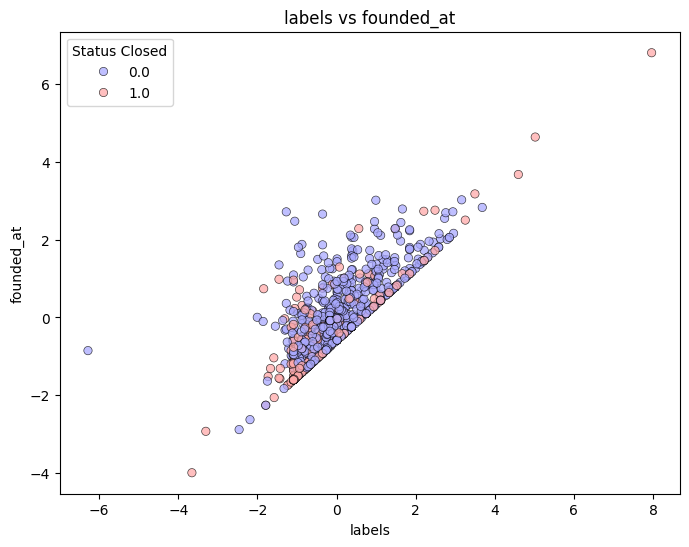

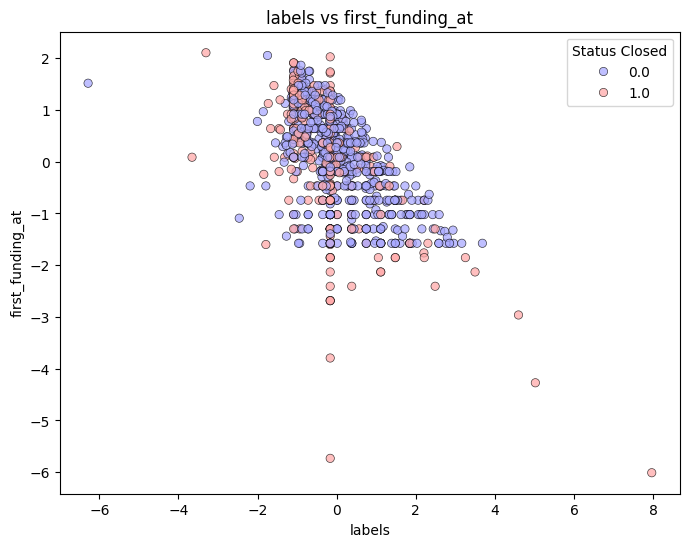

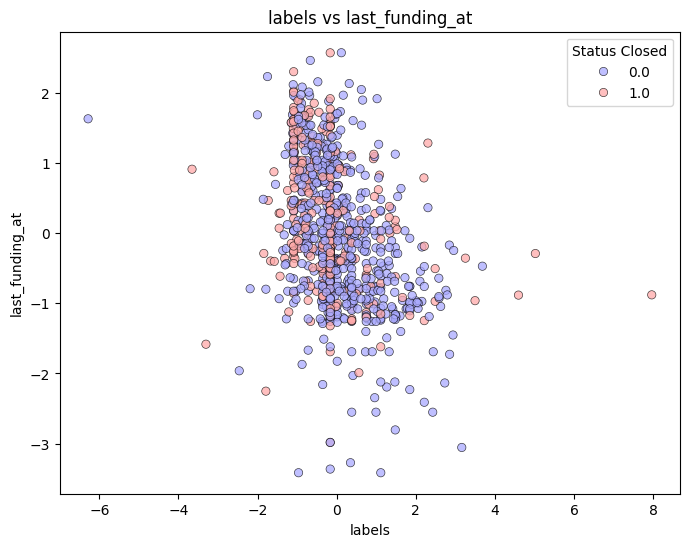

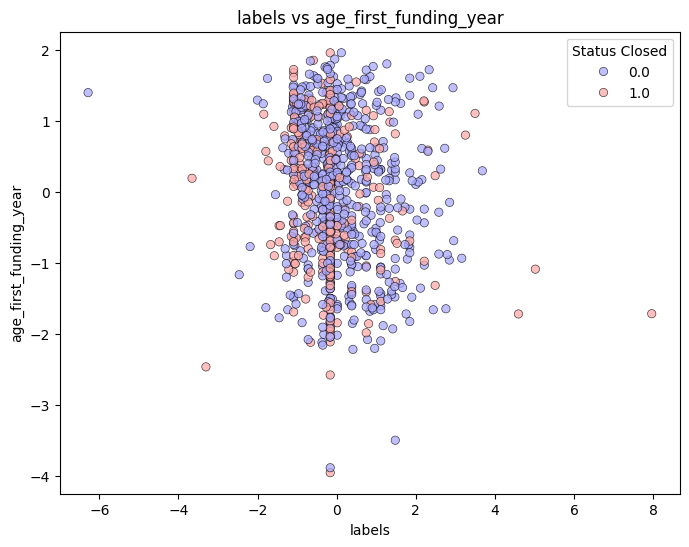

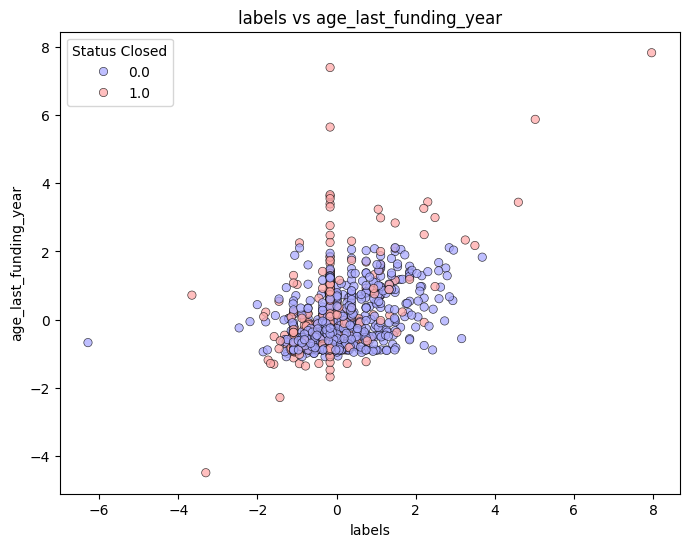

...

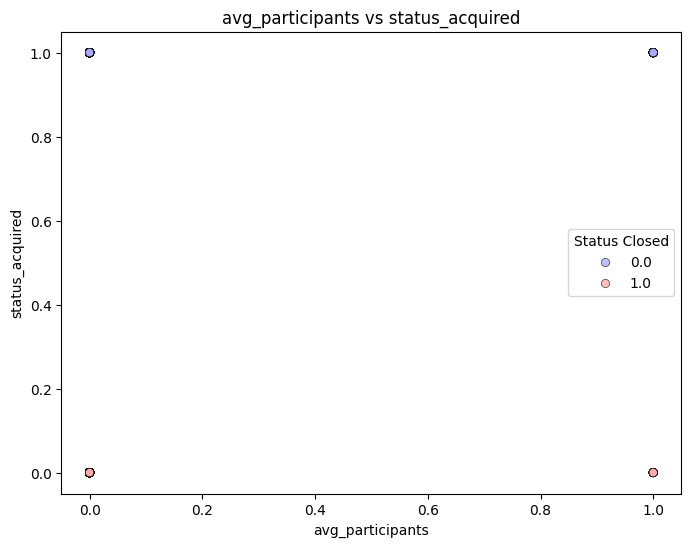

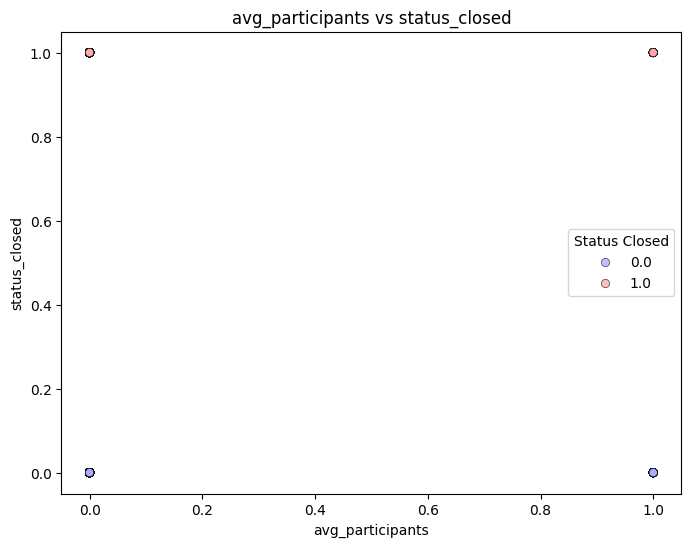

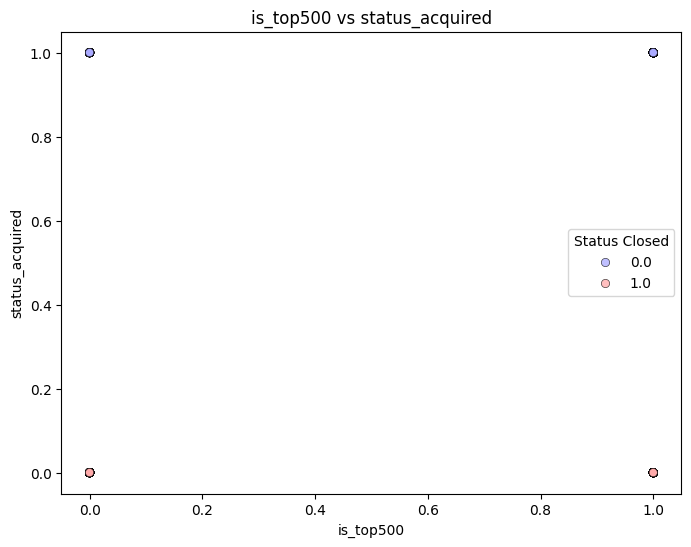

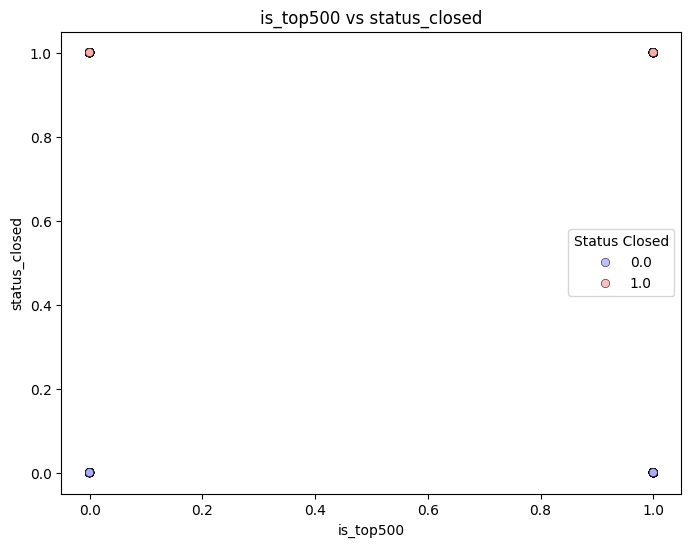

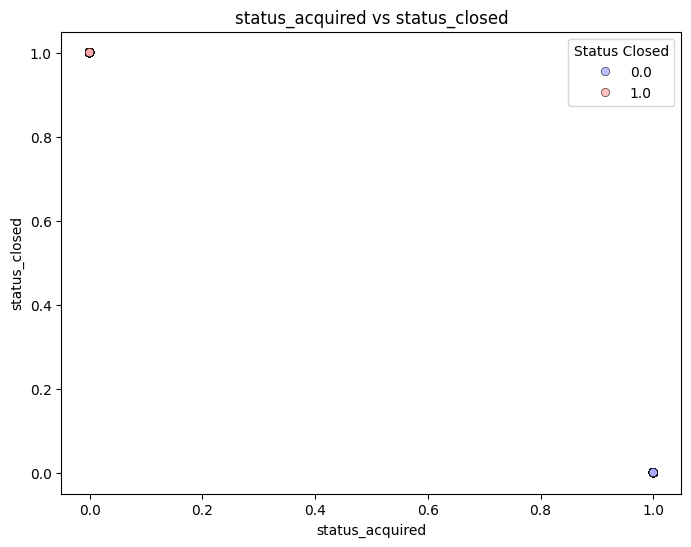

In [ ]:
feature_pairs = list(itertools.combinations(col_names, 2))
#using itertools to get combo of all variables to visualize and see if there r any patterns
for pair in feature_pairs:
    plt.figure(figsize=(8, 6))
    sns.scatterplot(
        data=df_tf,
        x=pair[0],
        y=pair[1],
        hue='status_closed',
        palette='bwr', 
        edgecolor='k',
        alpha=0.75  
    )
    plt.title(f'{pair[0]} vs {pair[1]}')
    plt.xlabel(pair[0])
    plt.ylabel(pair[1])
    plt.legend(title='Status Closed')
    plt.show()
    #with the graphs i just noticed i have some variables that correlate 1:1 with status_closed
    #didnt use feature selection, might need to do that before proceeding